In [22]:
%pip install trimesh
%pip install matplotlib
%pip install scipy
%pip install numpy
# Importing the necessary module from the ElementTree library

Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


# 2. Forward Kinematics 1



In [23]:
# Import Libraries

# URDF parsing Libraries
from xml.etree import ElementTree as ET
from xml.etree.ElementTree import Element


# Mathematical operation Libraries
import numpy as np

# 3D visualization Libraries
import trimesh
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D, art3d

# Native Libraries
from typing import Union

### Problem1: Extracting and Printing Link Information from a URDF File

Link는 큰 2가지 정보를 포함한다
1. Visual Geometry
2. Collision Geometry

---

1. You must extract detailed information about each \<link\> element.
2. The script 
    1. should iterate through all \<link\> tags in the URDF file
    2. gather information about link names
    3. visual and collision geometries (including their types and dimensions)
    4. any defined materials and colors.

For each \<link\>, the required details to extract and print include:

1. The name of the link.
2. Visual geometry type (e.g., box, cylinder, sphere, mesh), its parameters (e.g., size, length, radius), and origin information (position \[XYZ\] and orientation \[RPY\]).
4. Collision geometry type, its parameters, and origin information, similarly to the visual geometry.
4. The RGBA color values if a material color is specified for the visual geometry.

Requirements:

1. Implement a Python function, `print_link_info(urdf_path: str)`, that accepts the `path` to a URDF file as input.
2. Use the `xml.etree.ElementTree` module to **parse the URDF XML structure**.
3. For each `link`, print the gathered information in a structured and readable format. Here is an example.
    
    ```bash
    Link Name: panda_link_0
      Visual Geometry Type: mesh
        Filename: meshes/visual/link0.stl
        Color: 1. 1. 1. 1.
      Collision Geometry Type: mesh
        Filename: meshes/collision/link0.stl
    ---
    Link Name: panda_pedestal
      Visual Origin Position: 0.26 0.345 -0.91488
      Visual Origin Orientation: 1.57079632679 0 -1.57079632679
      Visual Geometry Type: mesh
        Filename: meshes/panda_pedestal/pedestal.STL
        Color: .2 .2 .2 1
      Collision Origin Position: -0.02 0 -0.29
      Collision Origin Orientation: 0 0 0
      Collision Geometry Type: cylinder
        Parameters: {'length': '0.62', 'radius': '0.18'}
    ```

In [24]:
def print_link_info(urdf_path: str) -> None:
    """
    Parses a URDF file and prints information about each link, including visual
    and collision geometries.

    Parameters:
    - urdf_path (str): Path to the URDF file.
    """
    # Load and parse the URDF file
    tree = ET.parse(urdf_path)
    root = tree.getroot()

    # Iterate through each link in the URDF
    for link in root.findall("link"):
        # Print the link's name
        print(f"Link Name: {link.attrib.get('name')}")

        for visual in link.findall("visual"):
            if visual is None:
                continue

            # Origin visual
            origin_visual = visual.find("origin")
            if origin_visual is not None:
                visual_origin_position = origin_visual.attrib.get(
                    "xyz"  # position x-y-z
                )
                visual_origin_orientation = origin_visual.attrib.get(
                    "rpy"  # roll-pitch-yaw
                )

                if visual_origin_position is not None:
                    print(f"\tVisual Origin Position: {visual_origin_position}")
                if visual_origin_orientation is not None:
                    print(f"\tVisual Origin Orientation: {visual_origin_orientation}")

            # Geometry visual
            geometry_visual = visual.find("geometry")

            if geometry_visual is not None:
                visual_geometry_shape = list(geometry_visual)[0]
                print(f"\tGeometry Type: {visual_geometry_shape.tag}")

                if visual_geometry_shape.tag == "mesh":
                    filename = visual_geometry_shape.attrib.get("filename")
                    if filename is not None:
                        print(f"\tGeometry Mesh Filename: {filename}")
                elif visual_geometry_shape.tag in ["box", "cylinder", "sphere"]:
                    geometry_params = visual_geometry_shape.attrib
                    if geometry_params is not None:
                        print(f"\tGeometry Parameters: {geometry_params}")

            # Geometry material information
            geometry_material = visual.find("material")

            if geometry_material is not None:
                color = geometry_material.find("color")
                color_attrib_keys = color.attrib.keys()
                for key in color_attrib_keys:
                    print(f"\t - {key}: {color.attrib[key]}")

        # Collision elements
        for collision in link.findall("collision"):
            if collision is None:
                continue

            # Collision origin
            collision_origin = collision.find("origin")

            if collision_origin is not None:
                collision_origin_position = collision_origin.attrib.get("xyz")
                collision_origin_orientation = collision_origin.attrib.get("rpy")
                if collision_origin_position is not None:
                    print(f"\tCollision Origin Position: {collision_origin_position}")
                if collision_origin_orientation is not None:
                    print(
                        f"\tCollision Origin Orientation: {collision_origin_orientation}"
                    )

            # Process and print information about the collision geometry
            collision_geometry = collision.find("geometry")
            if collision_geometry is not None:
                collision_geometry_type = list(collision_geometry)[0].tag
                print(f"\tCollision Geometry Type: {collision_geometry_type}")

                if collision_geometry_type == "mesh":
                    filename = collision_geometry.find("mesh").attrib.get("filename")
                    if filename is not None:
                        print(f"\tCollision Geometry Mesh Filename: {filename}")
                elif collision_geometry_type in ["box", "cylinder", "sphere"]:
                    geometry_params = collision_geometry.find(
                        collision_geometry_type
                    ).attrib
                    if geometry_params is not None:
                        print(f"\tCollision Geometry Parameters: {geometry_params}")

        # Separator for readability
        print("-" * 50)


# Example usage
urdf_path = "urdf/panda/panda.urdf"
# urdf_path = "urdf/ur5e/ur5e.urdf"
print_link_info(urdf_path)

Link Name: panda_link_0
	Geometry Type: mesh
	Geometry Mesh Filename: meshes/visual/link0.stl
	 - rgba: 1. 1. 1. 1.
	Collision Geometry Type: mesh
	Collision Geometry Mesh Filename: meshes/collision/link0.stl
--------------------------------------------------
Link Name: panda_pedestal
	Visual Origin Position: 0.26 0.345 -0.91488
	Visual Origin Orientation: 1.57079632679 0 -1.57079632679
	Geometry Type: mesh
	Geometry Mesh Filename: meshes/panda_pedestal/pedestal.STL
	 - rgba: .2 .2 .2 1
	Collision Origin Position: -0.02 0 -0.29
	Collision Origin Orientation: 0 0 0
	Collision Geometry Type: cylinder
	Collision Geometry Parameters: {'length': '0.62', 'radius': '0.18'}
--------------------------------------------------
Link Name: panda_controller_box
	Collision Origin Position: -0.325 0 -0.38
	Collision Origin Orientation: 0 0 0
	Collision Geometry Type: box
	Collision Geometry Parameters: {'size': '0.22 0.4 0.53'}
--------------------------------------------------
Link Name: panda_pedest

### Problem 2: Extracting and Printing Joint Information from a URDF File

You must extract and display information about each \<joint\> element. The script should navigate through all \<joint\> tags present in the URDF document, accumulating details such as joint names, types, parent and child link names, and the joint's origin (position and orientation). For joints that have limits, the script should also extract and print the limit values.

For each \<joint\>, you are required to extract and print the following details:

1. The name of the joint.
2. The type of the joint (e.g., revolute, prismatic, fixed, etc.).
3. Names of the parent and child links connected by the joint.
4. The origin of the joint (position \[XYZ\] and orientation \[RPY\]).
5. The axis of the joint.
6. The limit values for the joint, if applicable (including effort and velocity).

Requirements:

1. Implement a Python function named print_joint_info(urdf_path) that receives the path to a URDF file as its argument.
2. Use xml.etree.ElementTree for parsing the URDF XML structure.
3. The function should print each joint's gathered information in a clear, structured format. Examples are as follows:


```bash
Joint Name: panda_pedestal_feet_fixed
  Type: fixed
  Parent Link: panda_link_0
  Child Link: panda_pedestal_feet
  Origin Position: 0.0 0.0 0.0
  Origin Orientation: 0 0 0
---
Joint Name: panda_joint1
  Type: revolute
  Parent Link: panda_link_0
  Child Link: panda_link_1
  Origin Position: 0 0 0.333
  Origin Orientation: 0 0 0
  Axis: 0 0 1
  Limits - Lower: -2.9671, Upper: 2.9671, Effort: 87, Velocity: 2.1750
```

In [25]:
def print_joint_info(urdf_path: str) -> None:
    """
    Parses a URDF file and prints information about each joint, including its type,
    parent and child links, origin, axis, and limits.

    Parameters:
    - urdf_path (str): Path to the URDF file.
    """
    # Load and parse the URDF file
    tree = ET.parse(urdf_path)
    root = tree.getroot()

    # Iterate through each joint in the URDF
    for joint in root.findall("joint"):
        # Print the joint's name and type
        print(f"Joint Name: {joint.attrib['name']}")
        print(f"\tType: {joint.attrib['type']}")

        # Print parent and child links
        parent_link = joint.find("parent").attrib.get("link")
        child_link = joint.find("child").attrib.get("link")
        if parent_link is not None:
            print(f"\tParent Link: {parent_link}")
        if child_link is not None:
            print(f"\tChild Link: {child_link}")

        # Process and print information about the joint's origin
        origin = joint.find("origin")
        if origin is not None:
            print(f"\tOrigin Position: {origin.attrib.get('xyz')}")
            print(f"\tOrigin Orientation: {origin.attrib.get('rpy')}")

        # Process and print information about the joint's axis (if applicable)
        join_axis = joint.find("axis")
        if join_axis is not None:
            print(f"\tScrew Axis: {joint.find('axis').attrib.get('xyz')}")

        # Process and print information about the joint's limits (if applicable)
        joint_limits = joint.find("limit")
        if joint_limits is not None:
            print("\tJoint Limits:")
            joint_limit_keys = joint_limits.attrib.keys()
            for key in joint_limit_keys:
                print(f"\t  - {key}: {joint_limits.attrib.get(key)}")

        # Separator for readability
        print("-" * 50)


# Example usage
urdf_path = "urdf/panda/panda.urdf"
print_joint_info(urdf_path)

Joint Name: panda_pedestal_fixed
	Type: fixed
	Parent Link: panda_link_0
	Child Link: panda_pedestal
	Origin Position: 0.0 0.0 0.0
	Origin Orientation: 0 0 0
--------------------------------------------------
Joint Name: panda_controller_box_fixed
	Type: fixed
	Parent Link: panda_link_0
	Child Link: panda_controller_box
	Origin Position: 0.0 0.0 0.0
	Origin Orientation: 0 0 0
--------------------------------------------------
Joint Name: panda_pedestal_feet_fixed
	Type: fixed
	Parent Link: panda_link_0
	Child Link: panda_pedestal_feet
	Origin Position: 0.0 0.0 0.0
	Origin Orientation: 0 0 0
--------------------------------------------------
Joint Name: panda_joint1
	Type: revolute
	Parent Link: panda_link_0
	Child Link: panda_link_1
	Origin Position: 0 0 0.333
	Origin Orientation: 0 0 0
	Screw Axis: 0 0 1
	Joint Limits:
	  - effort: 87
	  - lower: -2.9671
	  - upper: 2.9671
	  - velocity: 2.1750
--------------------------------------------------
Joint Name: panda_joint2
	Type: revolute

### Prob 3. Parsing a URDF File to Extract Robot Structure

You should develop a Python script that parses a URDF (Unified Robot Description Format) file to extract detailed information about a robot's structure, including its links and joints, as well as visual and collision geometries.

The script should also visualize the hierarchical structure of the robot in a clear, readable format.

URDF files provide a comprehensive XML-based description of a robot's physical components, specifying how links (rigid bodies) are connected via joints and how each component is visually represented and interacts with the environment. This problem involves extracting these details to understand the robot's construction and kinematics.

__Requirements__:

1. Python Classes for Robot Components:
    1. Implement a `Link` class
        1. 목표: represent the **robot's links**
        2. store the **link's name**
        3. store lists of **associated Visual and Collision objects**.
    2. Implement a `Joint` class
        목표: **encapsulate the joint's `name`, `type` (e.g., revolute, prismatic), `parent` and `child` link names, `origin` (position and orientation), `motion axis`, and `limits` (if applicable)**.
    3. The `Visual` and `Collision` classes should hold attributes for origin position, origin orientation, geometry type (e.g., mesh, box), and additional specifics like filename for meshes or size parameters for primitive shapes.
    4. The `Visual` class should also include color information.

2. Geometry Parsing:
  - Design a parse_geometry function to process <geometry> subelements within <visual> or <collision> elements, identifying the geometry type and extracting relevant attributes, such as mesh filename or dimensions for primitive shapes.

3. Limits Parsing:
  - Create a parse_limits function to extract motion range, effort, and velocity limits from <limit> subelements found within <joint> elements.

4. URDF Parsing and Robot Structure Creation:
  - Develop a parse_urdf function that accepts a URDF file path, parses the file, and constructs a hierarchy of Link and Joint objects populated with data from the URDF. Identify and return the root link of the robot structure.
  
5. Information Visualization:
  - The script must print out extracted information in a structured format, clearly delineating different links and joints and presenting attributes like origins, orientations, and limits in an organized manner. Additionally, implement a print_link_tree function to recursively print the robot's hierarchical structure, showing parent-child relationships between links and joints.

Output Example:
```bash
Robot Structure:
Link: panda_link_0
  Joint: panda_pedestal_fixed -> panda_pedestal
  Link: panda_pedestal
  Joint: panda_controller_box_fixed -> panda_controller_box
  Link: panda_controller_box
  Joint: panda_pedestal_feet_fixed -> panda_pedestal_feet
  Link: panda_pedestal_feet
  Joint: panda_joint1 -> panda_link_1
  Link: panda_link_1
    Joint: panda_joint2 -> panda_link_2
    Link: panda_link_2
      Joint: panda_joint3 -> panda_link_3
      Link: panda_link_3
        Joint: panda_joint4 -> panda_link_4
        Link: panda_link_4
          Joint: panda_joint5 -> panda_link_5
          Link: panda_link_5
            Joint: panda_joint6 -> panda_link_6
            Link: panda_link_6
              Joint: panda_joint7 -> panda_link_7
              Link: panda_link_7
                Joint: right_hand_fixed -> right_hand
                Link: right_hand
                  Joint: panda_right_gripper_fixed -> right_gripper
                  Link: right_gripper
                    Joint: panda_finger_joint1 -> leftfinger
                    Link: leftfinger
                    Joint: panda_finger_joint2 -> rightfinger
                    Link: rightfinger
                  Joint: panda_eef_fixed -> tcp
                  Link: tcp
```

In [26]:
from xml.etree.ElementTree import ElementTree


def convert_string_to_narray(str_input: str):
    """
    Args:
        str_input (str): string

    Returns:
        np.array: Returns string to np.array
    """
    if str_input is None:
        return np.array([0, 0, 0])
    return np.array([float(data) for data in str_input.split()])


class Visual:
    def __init__(
        self, origin_position, origin_orientation, geometry_type, filename, color
    ):
        self.origin_position = origin_position
        self.origin_orientation = origin_orientation
        self.geometry_type = geometry_type
        self.filename = filename
        self.color = color


class Collision:
    def __init__(
        self,
        origin_position: str,
        origin_orientation: str,
        geometry_type: str,
        filename: Union[str, None] = None,
        parameters: Union[dict[str, any], None] = None,
    ):
        self.origin_position = origin_position
        self.origin_orientation = origin_orientation
        self.geometry_type = geometry_type
        self.filename = filename
        self.parameters = parameters


class Link:
    def __init__(self, name: str):
        self.name = name
        self.visuals: list[Visual] = []
        self.collisions: list[Collision] = []
        self.children: list[Joint] = []


class Joint:
    def __init__(
        self,
        name: str,
        joint_type: str,
        parent_link: Link,
        child_link: Link,
        origin_position: np.ndarray[np.float64],
        origin_orientation: np.ndarray[np.float64],
        axis: np.ndarray[np.float64],
        limits: Union[float, None] = None,
    ):
        self.name = name
        self.joint_type = joint_type
        self.parent_link = parent_link
        self.child_link = child_link
        self.origin_position = origin_position
        self.origin_orientation = origin_orientation
        self.axis = axis
        self.limits = limits


def parse_geometry(
    element: Element, prefix="./"
) -> tuple[str, Union[str, None], dict[str, str]]:
    geometry_type = list(element.find("geometry"))[0].tag
    filename = None
    parameters = {}
    if geometry_type == "mesh":
        filename = prefix + element.find("geometry/mesh").attrib["filename"]
    elif geometry_type in ["box", "cylinder", "sphere"]:
        parameters = element.find(f"geometry/{geometry_type}").attrib
    return geometry_type, filename, parameters


def parse_limits(element: Element):
    if element is None:
        return None
    limits: dict[str, any] = {
        "lower": element.attrib.get("lower"),
        "upper": element.attrib.get("upper"),
        "effort": element.attrib.get("effort"),
        "velocity": element.attrib.get("velocity"),
    }
    return limits


def parse_urdf(urdf_path: str, prefix: str = "./"):
    tree: ElementTree = ET.parse(prefix + urdf_path)
    root = tree.getroot()

    links: dict[str, Link] = {}
    joints: dict[str, Joint] = {}

    for elem_link in root.findall("link"):
        name: str = elem_link.attrib["name"]
        link: Link = Link(name)

        # Process visual elements
        for visual in elem_link.findall("visual"):
            origin = visual.find("origin")
            origin_pos = convert_string_to_narray(
                origin.attrib.get("xyz") if origin is not None else "0 0 0"
            )
            origin_orient = convert_string_to_narray(
                origin.attrib.get("rpy") if origin is not None else "0 0 0"
            )
            geom_type, filename, params = parse_geometry(visual, prefix=prefix)
            color = (
                visual.find("material/color").attrib.get("rgba")
                if visual.find("material/color") is not None
                else "N/A"
            )
            link.visuals.append(
                Visual(origin_pos, origin_orient, geom_type, filename, color)
            )

        # Process collision elements
        for collision in elem_link.findall("collision"):
            origin = collision.find("origin")
            origin_pos = convert_string_to_narray(
                origin.attrib.get("xyz") if origin is not None else "0 0 0"
            )
            origin_orient = convert_string_to_narray(
                origin.attrib.get("rpy") if origin is not None else "0 0 0"
            )
            geom_type, filename, params = parse_geometry(collision, prefix=prefix)
            link.collisions.append(
                Collision(origin_pos, origin_orient, geom_type, filename, params)
            )

        links[link.name] = link

    # Parse joints
    for elem_joint in root.findall("joint"):
        origin = elem_joint.find("origin")
        origin_pos = convert_string_to_narray(
            origin.attrib.get("xyz") if origin is not None else "0 0 0"
        )
        origin_orient = convert_string_to_narray(
            origin.attrib.get("rpy") if origin is not None else "0 0 0"
        )
        axis = elem_joint.find("axis")
        xyz_axis = convert_string_to_narray(
            axis.attrib.get("xyz") if axis is not None else "0 0 0"
        )
        limits = parse_limits(elem_joint.find("limit"))

        joint = Joint(
            name=elem_joint.attrib["name"],
            joint_type=elem_joint.attrib["type"],
            parent_link=links[elem_joint.find("parent").attrib["link"]],
            child_link=links[elem_joint.find("child").attrib["link"]],
            origin_position=origin_pos,
            origin_orientation=origin_orient,
            axis=xyz_axis,
            limits=limits,
        )
        joints[joint.name] = joint
        links[joint.parent_link.name].children.append(joint)

    root_link = next(
        link
        for link in links.values()
        if not any(joint.child_link == link for joint in joints.values())
    )
    return root_link, links, joints


# Example usage
prefix = "urdf/panda/"
urdf_path = "panda.urdf"

(root_link, link_dict, joint_dict) = parse_urdf(urdf_path, prefix=prefix)


def print_link_tree(link: Link, depth=0):
    """
    Recursively prints the hierarchy of links and joints in a readable format.
    """
    # Print the link's name
    print(f"{' ' * depth * 4}Link: {link.name}")

    for child in link.children:
        # Print the joint's name and child link
        print(f"{' ' * depth * 4}Joint: {child.name} -> Link: {child.child_link.name}")

        # Recursively print the child link's tree
        print_link_tree(child.child_link, depth + 1)


print("Robot Structure:")
print_link_tree(root_link)

Robot Structure:
Link: panda_link_0
Joint: panda_pedestal_fixed -> Link: panda_pedestal
    Link: panda_pedestal
Joint: panda_controller_box_fixed -> Link: panda_controller_box
    Link: panda_controller_box
Joint: panda_pedestal_feet_fixed -> Link: panda_pedestal_feet
    Link: panda_pedestal_feet
Joint: panda_joint1 -> Link: panda_link_1
    Link: panda_link_1
    Joint: panda_joint2 -> Link: panda_link_2
        Link: panda_link_2
        Joint: panda_joint3 -> Link: panda_link_3
            Link: panda_link_3
            Joint: panda_joint4 -> Link: panda_link_4
                Link: panda_link_4
                Joint: panda_joint5 -> Link: panda_link_5
                    Link: panda_link_5
                    Joint: panda_joint6 -> Link: panda_link_6
                        Link: panda_link_6
                        Joint: panda_joint7 -> Link: panda_link_7
                            Link: panda_link_7
                            Joint: right_hand_fixed -> Link: right_hand
     

### Problem 4: Mesh Visualization for Each Link in a URDF File using Trimesh in Colab

You should parse a `URDF` (Universal Robot Description Format) file to extract the paths of triangular mesh files associated with each <link> tag. Utilize the trimesh library to visualize these triangular meshes within a Google Colab notebook, providing a detailed representation of each robotic link's geometry. This task aims to facilitate a comprehensive visual understanding of the robot's structural design by rendering the geometric complexities of its components.

**Detailed Description of Triangular Mesh and Trimesh**:

**Triangular meshes**: 
1. common method for representing 3D geometries in robotics and computer graphics. 
2. consist of a collection of triangles connected by their vertices, forming the surface of a 3D object. 
3. particularly useful for visualizing robotic links, as it allows for the detailed rendering of complex shapes and surfaces.

**The `trimesh` library**, renowned for its ability to work efficiently with triangular meshes, supports loading, processing, and visualizing 3D mesh data in various formats (e.g., `STL`, `OBJ`). Leveraging trimesh in a Google Colab environment for mesh visualization offers an interactive and accessible way to inspect the design and geometry of robotic components defined in a URDF file.

### Requirements:

Your script will parse the URDF file, identify the paths to the triangular mesh files for each link, and render these meshes using trimesh, providing an interactive visualization within the Colab notebook.

1. Function Implementation: Write a function `visualize_link_meshes_with_trimesh(urdf_path, prefix='')` that accepts the path to a URDF file and an optional prefix for mesh file paths. This function **should extract the mesh paths** for each link and **visualize them using the trimesh library**.
2. Triangular Mesh Visualization: Utilize trimesh to load each triangular mesh file and display it within the Colab notebook. Confirm the completion of visualization for each mesh to provide clear feedback on the process.
Example:

```bash
Visualizing Link: panda_link_0
Mesh Filename: ./urdf/urdf/panda/meshes/visual/link0.stl

[Visualization with Trimesh]

-- Mesh ./urdf/urdf/panda/meshes/visual/link0.stl Visualization Completed --
----------------------------------------
Visualizing Link: panda_pedestal
Mesh Filename: ./urdf/urdf/panda/meshes/panda_pedestal/pedestal.STL

[Visualization with Trimesh]

-- Mesh ./urdf/urdf/panda/meshes/visual/link1.stl Visualization Completed --
```



In [30]:
from IPython.display import display


def visualize_mesh_with_trimesh(mesh_path: str):
    """
    Loads a mesh from the specified path and visualizes it using `trimesh` library.

    Args:
        mesh_path (str): The path to the mesh file.
    """
    # Attempt to load the specified mesh file using trimesh
    print(f"Visualizing Mesh: {mesh_path}")
    mesh = trimesh.load(mesh_path)

    # Check if the mesh was loaded successfully
    if mesh is not None:
        # If successfully loaded, display the mesh using IPython's display function
        display(mesh.show())
        print(f"-- Mesh {mesh_path} Visualization Completed --")
    else:
        # If the mesh fails to load, print an error message
        print(f"Failed to load mesh from {mesh_path}")


def visualize_link_meshes_with_trimesh(urdf_path, prefix="./"):
    """
    Parses a URDF file and visualizes all mesh files associated with the links
    in the robot model using trimesh.

    Args:
        urdf_path (str): The path to the URDF file, relative to the current working directory.
        prefix (str): The prefix added to relative paths found in the URDF,
                      useful for locating mesh files in a different directory.
    """
    # Parse the URDF file to obtain the root link and a dictionary of all links
    # This assumes the parse_urdf function is implemented to return the root link,
    # a dictionary of links, and a dictionary of joints
    _, links, _ = parse_urdf(urdf_path, prefix=prefix)

    # Iterate through each link in the links dictionary
    for name, link in links.items():
        # Each link may have multiple visuals, iterate through them
        for visual in link.visuals:
            # Print the name of the link being visualized and the mesh filename
            print(f"Visualizing Link: {name}")
            print(f"Mesh Filename: {visual.filename}")
            # Call visualize_mesh_with_trimesh to visualize the mesh file
            if visual.filename is not None:
                visualize_mesh_with_trimesh(visual.filename)
            # Print a separator for readability
            print("-" * 40)


# Example call to visualize link meshes in a URDF
prefix = "urdf/panda/"
urdf_path = "panda.urdf"
visualize_link_meshes_with_trimesh(urdf_path, prefix=prefix)

Visualizing Link: panda_link_0
Mesh Filename: urdf/panda/meshes/visual/link0.stl
Visualizing Mesh: urdf/panda/meshes/visual/link0.stl


-- Mesh urdf/panda/meshes/visual/link0.stl Visualization Completed --
----------------------------------------
Visualizing Link: panda_pedestal
Mesh Filename: urdf/panda/meshes/panda_pedestal/pedestal.STL
Visualizing Mesh: urdf/panda/meshes/panda_pedestal/pedestal.STL


-- Mesh urdf/panda/meshes/panda_pedestal/pedestal.STL Visualization Completed --
----------------------------------------
Visualizing Link: panda_link_1
Mesh Filename: urdf/panda/meshes/visual/link1.stl
Visualizing Mesh: urdf/panda/meshes/visual/link1.stl


-- Mesh urdf/panda/meshes/visual/link1.stl Visualization Completed --
----------------------------------------
Visualizing Link: panda_link_2
Mesh Filename: urdf/panda/meshes/visual/link2.stl
Visualizing Mesh: urdf/panda/meshes/visual/link2.stl


-- Mesh urdf/panda/meshes/visual/link2.stl Visualization Completed --
----------------------------------------
Visualizing Link: panda_link_3
Mesh Filename: urdf/panda/meshes/visual/link3.stl
Visualizing Mesh: urdf/panda/meshes/visual/link3.stl


-- Mesh urdf/panda/meshes/visual/link3.stl Visualization Completed --
----------------------------------------
Visualizing Link: panda_link_4
Mesh Filename: urdf/panda/meshes/visual/link4.stl
Visualizing Mesh: urdf/panda/meshes/visual/link4.stl


-- Mesh urdf/panda/meshes/visual/link4.stl Visualization Completed --
----------------------------------------
Visualizing Link: panda_link_5
Mesh Filename: urdf/panda/meshes/visual/link5.stl
Visualizing Mesh: urdf/panda/meshes/visual/link5.stl


-- Mesh urdf/panda/meshes/visual/link5.stl Visualization Completed --
----------------------------------------
Visualizing Link: panda_link_6
Mesh Filename: urdf/panda/meshes/visual/link6.stl
Visualizing Mesh: urdf/panda/meshes/visual/link6.stl


-- Mesh urdf/panda/meshes/visual/link6.stl Visualization Completed --
----------------------------------------
Visualizing Link: panda_link_7
Mesh Filename: urdf/panda/meshes/visual/link7.stl
Visualizing Mesh: urdf/panda/meshes/visual/link7.stl


-- Mesh urdf/panda/meshes/visual/link7.stl Visualization Completed --
----------------------------------------
Visualizing Link: right_gripper
Mesh Filename: urdf/panda/meshes/visual/hand.stl
Visualizing Mesh: urdf/panda/meshes/visual/hand.stl


-- Mesh urdf/panda/meshes/visual/hand.stl Visualization Completed --
----------------------------------------
Visualizing Link: leftfinger
Mesh Filename: urdf/panda/meshes/visual/finger.stl
Visualizing Mesh: urdf/panda/meshes/visual/finger.stl


-- Mesh urdf/panda/meshes/visual/finger.stl Visualization Completed --
----------------------------------------
Visualizing Link: rightfinger
Mesh Filename: urdf/panda/meshes/visual/finger.stl
Visualizing Mesh: urdf/panda/meshes/visual/finger.stl


-- Mesh urdf/panda/meshes/visual/finger.stl Visualization Completed --
----------------------------------------


# Reference frame of each link and joint in URDF

The reference frame for defining the origins and axes of links, joints, and geometries (including meshes) is critical for understanding the spatial relationships and transformations within a robot model. Each element's position and orientation are defined relative to a specific reference frame, which is essential for accurately modeling the robot's kinematics and appearance. Here's a breakdown of how reference frames are used for different elements in URDF:

1. Link's Origin
Reference Frame: The origin of a link is typically defined relative to its parent joint's frame.

2. Joint's Origin and Axis
Reference Frame: The origin and axis of a joint are defined relative to the parent link's frame to which the joint is attached.

3. Origin of Meshes or Geometry
Reference Frame: The origin of meshes or other geometrical elements (used for visualization or collision detection) is defined relative to the link's frame to which the geometry is attached.

### Problem 5: Visualizing Default Pose of Robot Kinematics and Meshes

> 🔮 Goal: Calculate M matrix

You should implement a Python code that visualizes the kinematic chain of a robot using transformation matrices for each link and joint. Additionally, the program should concatenate and display the 3D meshes associated with each link in a separate visualization.

In robotics, understanding the spatial configuration and visual representation of robots is crucial. This problem involves computing the forward kinematics to determine the position and orientation of each link in a robot's kinematic chain and visualizing the combined 3D mesh of the robot as specified in a Unified Robot Description Format (URDF) file.

__Requirements__

1. Compute Forward Kinematics for Home Configuration ($\theta=0$):
  - Given a robot's URDF file, parse the kinematic structure, including links and joints.
  - Implement a function to compute the homogeneous transformation matrices based on Roll-Pitch-Yaw (RPY) angles and positions for each link.
  - Recursively calculate the forward kinematics to determine the transformation of each link relative to the base frame.
2. Print Link Positions:
  - After computing the forward kinematics, print the position of each link in the robot's kinematic chain.
3. Visualize Kinematic Frames:
  - Visualize the X, Y, and Z axes of each frame in the robot's kinematic chain using matplotlib.
  - Include the name of each link next to its frame.
4. Concatenate and Visualize 3D Meshes:
  - For each link with an associated 3D mesh, apply the computed transformation to the mesh.
  - Concatenate all link meshes into a single mesh object.
  - Use the trimesh library to visualize the combined mesh in a separate figure.

Example of Output:
```bash
Link Positions:
Link: panda_link_0, Position: [0. 0. 0.]
  Link: panda_pedestal, Position: [0. 0. 0.]
  Link: panda_controller_box, Position: [0. 0. 0.]
  Link: panda_pedestal_feet, Position: [0. 0. 0.]
  Link: panda_link_1, Position: [0.    0.    0.333]
    Link: panda_link_2, Position: [0.    0.    0.333]
      Link: panda_link_3, Position: [ 0.00000000e+00 -1.54732208e-12  6.49000000e-01]
        Link: panda_link_4, Position: [ 8.25000000e-02 -1.54732208e-12  6.49000000e-01]
          Link: panda_link_5, Position: [0.00000000e+00 3.32968042e-13 1.03300000e+00]
            Link: panda_link_6, Position: [0.00000000e+00 3.32968042e-13 1.03300000e+00]
              Link: panda_link_7, Position: [8.80000000e-02 3.32968042e-13 1.03300000e+00]
                Link: right_hand, Position: [ 8.80000000e-02 -7.10005385e-13  9.26500000e-01]
                  Link: right_gripper, Position: [ 8.80000000e-02 -7.10005385e-13  9.26500000e-01]
                    Link: leftfinger, Position: [ 0.1162982  -0.02827033  0.8741    ]
                    Link: rightfinger, Position: [0.0597018  0.02827033 0.8741    ]
                  Link: tcp, Position: [ 8.80000000e-02 -1.65994362e-12  8.29500000e-01]
```
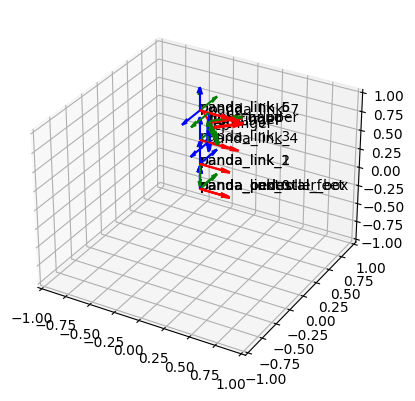
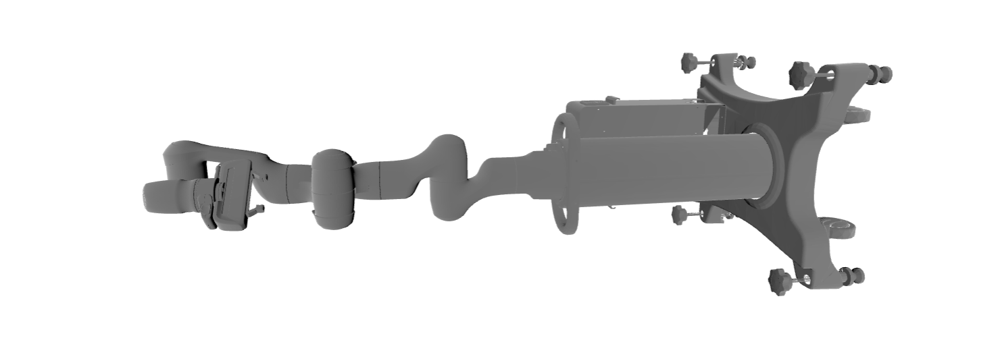

Link Positions:
Link: panda_link_0, Position: [0. 0. 0.]
  Link: panda_pedestal, Position: [0. 0. 0.]
  Link: panda_controller_box, Position: [0. 0. 0.]
  Link: panda_pedestal_feet, Position: [0. 0. 0.]
  Link: panda_link_1, Position: [0.    0.    0.333]
    Link: panda_link_2, Position: [0.    0.    0.333]
      Link: panda_link_3, Position: [ 0.00000000e+00 -1.54732208e-12  6.49000000e-01]
        Link: panda_link_4, Position: [ 8.25000000e-02 -1.54732208e-12  6.49000000e-01]
          Link: panda_link_5, Position: [0.00000000e+00 3.32968042e-13 1.03300000e+00]
            Link: panda_link_6, Position: [0.00000000e+00 3.32968042e-13 1.03300000e+00]
              Link: panda_link_7, Position: [8.80000000e-02 3.32968042e-13 1.03300000e+00]
                Link: right_hand, Position: [ 8.80000000e-02 -7.10005385e-13  9.26500000e-01]
                  Link: right_gripper, Position: [ 8.80000000e-02 -7.10005385e-13  9.26500000e-01]
                    Link: leftfinger, Position: [ 0.11629

-- Combined Mesh Visualization Completed --


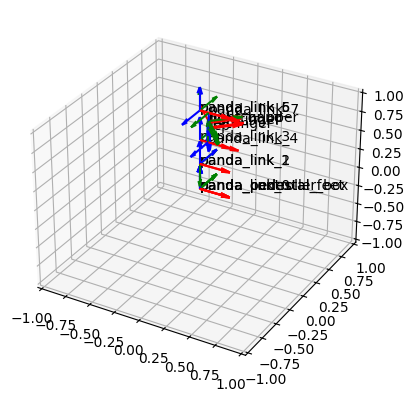

In [28]:
def draw_frame(
    ax: np.ndarray[np.float64], T: np.ndarray[np.float64], name: str, scale=0.3
) -> None:
    """
    Draw the X, Y, and Z axes of a frame based on the transformation matrix.
    """
    # Origin of the frame
    origin = T[:3, 3]

    # Directions of the X, Y, Z axes transformed by the rotation part of T
    x_dir = T[:3, :3] @ np.array([scale, 0, 0])
    y_dir = T[:3, :3] @ np.array([0, scale, 0])
    z_dir = T[:3, :3] @ np.array([0, 0, scale])

    # Draw the axes, use reference to optimize performance
    ax.quiver(*origin, *x_dir, color="r", length=scale, normalize=True)
    ax.quiver(*origin, *y_dir, color="g", length=scale, normalize=True)
    ax.quiver(*origin, *z_dir, color="b", length=scale, normalize=True)
    # Add the frame name as text
    ax.text(*origin, name, color="black")


def rpy_to_rotation_matrix(rpy: tuple[float, float, float]) -> np.ndarray[np.float64]:
    """
    Convert roll-pitch-yaw angles into a rotation matrix.

    Args:
        rpy (tuple/list/np.array): The roll, pitch, and yaw angles.

    Returns:
        np.array: The corresponding rotation matrix.
    """
    roll, pitch, yaw = rpy
    Rx = np.array(
        [
            [1, 0, 0],
            [0, np.cos(roll), -np.sin(roll)],
            [0, np.sin(roll), np.cos(roll)],
        ]
    )
    Ry = np.array(
        [
            [np.cos(pitch), 0, np.sin(pitch)],
            [0, 1, 0],
            [-np.sin(pitch), 0, np.cos(pitch)],
        ]
    )
    Rz = np.array(
        [
            [np.cos(yaw), -np.sin(yaw), 0],
            [np.sin(yaw), np.cos(yaw), 0],
            [0, 0, 1],
        ]
    )
    # Convert RPY to rotation matrix
    return Rz @ Ry @ Rx


def compute_transformation(
    rpy: tuple[float, float, float], position: np.ndarray[np.float64]
) -> np.ndarray[np.float64]:
    """
    Compute a homogeneous transformation matrix from RPY angles and position.

    Args:
        rpy (tuple/list/np.array): Roll, pitch, and yaw angles.
        position (tuple/list/np.array): The x, y, z position.

    Returns:
        np.array: The 4x4 homogeneous transformation matrix.
    """
    R = rpy_to_rotation_matrix(rpy)
    T = np.eye(4)

    T[:3, :3] = R
    T[:3, 3] = position

    return T
    # Compute transformation matrix


def initial_forward_kinematics(link: Link, chain_transformation=np.eye(4)):
    """
    Recursively computes the forward kinematics for the robot, updating each link's
    transformation matrix relative to the base frame. This function traverses the robot's
    kinematic chain from the base link to the end-effectors.

    All thetas are 0, so don't have to calculate Skew matrix chaining

    Args:
        link (Link): The current link object being processed. Initially, this should
                     be the root link of the robot.
        chain_transformation (np.array): The accumulated transformation matrix representing
                                         the position and orientation of the current link
                                         with respect to the base frame. Initially, this
                                         is an identity matrix for the base link.
    """
    # Update the transformation matrix of the current link.
    # This matrix transforms points from the link's local frame to the global frame.
    link.transformation = chain_transformation

    # Iterate through all child joints of the current link.
    for child_joint in link.children:
        # Calculate the transformation matrix from the current link to the child link.
        T_joint_to_child = compute_transformation(
            # 회전축
            child_joint.origin_orientation,
            child_joint.origin_position,
        )
        # This involves computing the rotation from RPY angles and translating along the joint's origin position. For movable joints, the joint's configuration (e.g., angle) would also influence this transformation.
        # Multiply the current chain transformation by the newly computed transformation to get the transformation matrix for the child link relative to the base frame.
        # Recursively apply the forward kinematics computation to the child link, passing along the updated transformation matrix.

        # Compute transformation matrix from joint to child link
        child_transformation = chain_transformation @ T_joint_to_child
        initial_forward_kinematics(child_joint.child_link, child_transformation)


def print_link_positions(link: Link, level: int = 0) -> None:
    """
    Recursively print the positions of each link in the robot structure.

    Args:
        link (Link): The current link.
        level (int): The current depth in the robot structure for indentation.
    """
    indent = "  " * level
    position = link.transformation[:3, 3]
    print(f"{indent}Link: {link.name}, Position: {position}")
    for child_joint in link.children:
        # Print the position of each link recursively
        print_link_positions(child_joint.child_link, level + 1)


def visualize_robot_frames_with_axes(root_link: Link) -> None:
    """
    Visualize the frames of a robot with axes for each link.

    Args:
        root_link (Link): The root link of the robot structure.
    """
    # Setup plot and recursively draw each link's frame
    fig = plt.figure()
    ax = fig.add_subplot(111, projection="3d")

    def recurse_links(link: Link) -> None:
        draw_frame(ax, link.transformation, link.name)
        for child_joint in link.children:
            recurse_links(child_joint.child_link)

    recurse_links(root_link)
    ax.set_xlim([-1, 1]), ax.set_ylim([-1, 1]), ax.set_zlim([-1, 1])


def visualize_robot_with_meshes(links: dict[str, Link]) -> None:
    """
    Visualize the combined mesh of all links in the robot structure.

    Args:
        links (dict): A dictionary of links with their names as keys.
    """
    # Combine and visualize all link meshes
    combined_mesh = None
    for name, link in links.items():
        if link.visuals is not None:
            for visual in link.visuals:
                if visual.filename is not None:
                    filename = visual.filename
                    T_link_to_mesh = compute_transformation(
                        visual.origin_orientation, visual.origin_position
                    )
                    # Assuming the mesh path is correct and accessible
                    print(f"Visualizing Mesh: {filename}")
                    mesh = trimesh.load_mesh(filename)
                    mesh.apply_transform(link.transformation @ T_link_to_mesh)

                    if combined_mesh is None:
                        combined_mesh = mesh
                    else:
                        combined_mesh += mesh

    # Display the combined mesh
    if combined_mesh is not None:
        display(combined_mesh.show())
        print("-- Combined Mesh Visualization Completed --")
    else:
        print("No meshes to visualize.")


def visualize_default_forward_kinematics(
    urdf_path: str,
    prefix: str,
) -> None:
    link, link_dict, joint_dict = parse_urdf(urdf_path, prefix=prefix)

    # Compute forward kinematics with an example joint angle
    initial_forward_kinematics(link)

    # Print the positions of each link
    print("Link Positions:")
    print_link_positions(link)
    visualize_robot_frames_with_axes(link)
    visualize_robot_with_meshes(link_dict)


# Load the robot structure from the URDF file (see previous step)
prefix = "urdf/panda/"
urdf_path = "panda.urdf"
visualize_default_forward_kinematics(urdf_path, prefix=prefix)

### Problem 6: Repeat Problem 5 for other urdf files

Link Positions:
Link: ur5e_base_link, Position: [0. 0. 0.]
  Link: ur5e_pedestal, Position: [0. 0. 0.]
  Link: ur5e_controller_box, Position: [0. 0. 0.]
  Link: ur5e_pedestal_feet, Position: [0. 0. 0.]
  Link: ur5e_shoulder_link, Position: [0.    0.    0.163]
    Link: ur5e_upper_arm_link, Position: [0.    0.138 0.163]
      Link: ur5e_forearm_link, Position: [0.425 0.007 0.163]
        Link: ur5e_wrist_1_link, Position: [0.817 0.007 0.163]
          Link: ur5e_wrist_2_link, Position: [0.817 0.134 0.163]
            Link: ur5e_wrist_3_link, Position: [0.817 0.134 0.063]
              Link: ur5e_right_hand, Position: [0.817 0.232 0.063]
Visualizing Mesh: ./urdf/ur5e/meshes/visual/base_vis.stl
Visualizing Mesh: ./urdf/ur5e/meshes/ur5e_pedestal/pedestal.STL
Visualizing Mesh: ./urdf/ur5e/meshes/visual/shoulder_vis.stl
Visualizing Mesh: ./urdf/ur5e/meshes/visual/upperarm_vis.stl
Visualizing Mesh: ./urdf/ur5e/meshes/visual/forearm_vis.stl
Visualizing Mesh: ./urdf/ur5e/meshes/visual/wrist1_vi

-- Combined Mesh Visualization Completed --
Link Positions:
Link: ur5e_base_link, Position: [0. 0. 0.]
  Link: ur5e_pedestal, Position: [0. 0. 0.]
  Link: ur5e_controller_box, Position: [0. 0. 0.]
  Link: ur5e_pedestal_feet, Position: [0. 0. 0.]
  Link: ur5e_shoulder_link, Position: [0.    0.    0.163]
    Link: ur5e_upper_arm_link, Position: [0.    0.138 0.163]
      Link: ur5e_forearm_link, Position: [0.425 0.007 0.163]
        Link: ur5e_wrist_1_link, Position: [0.817 0.007 0.163]
          Link: ur5e_wrist_2_link, Position: [0.817 0.134 0.163]
            Link: ur5e_wrist_3_link, Position: [0.817 0.134 0.063]
              Link: ur5e_right_hand, Position: [0.817 0.232 0.063]
                Link: right_gripper, Position: [0.817  0.1695 0.063 ]
                  Link: left_outer_knuckle, Position: [0.786399   0.05307    0.06302437]
                    Link: left_outer_finger, Position: [0.786399   0.07907182 0.08124436]
                      Link: left_inner_finger, Position: [0.786

-- Combined Mesh Visualization Completed --
Link Positions:
Link: sawyer_base, Position: [0. 0. 0.]
  Link: sawyer_controller_box, Position: [0. 0. 0.]
  Link: sawyer_pedestal_feet, Position: [0. 0. 0.]
  Link: sawyer_pedestal, Position: [0. 0. 0.]
  Link: sawyer_right_arm_base_link, Position: [0. 0. 0.]
    Link: sawyer_link_0, Position: [0.   0.   0.08]
      Link: sawyer_head, Position: [0.     0.     0.3765]
        Link: sawyer_screen, Position: [0.03   0.     0.4815]
        Link: sawyer_head_camera, Position: [0.0228027 0.        0.593072 ]
      Link: sawyer_right_torso_itb, Position: [-0.055  0.     0.3  ]
      Link: sawyer_link_1, Position: [0.081 0.05  0.317]
        Link: sawyer_link_2, Position: [0.221  0.1925 0.317 ]
          Link: sawyer_link_3, Position: [0.481  0.1505 0.317 ]
            Link: sawyer_link_4, Position: [0.606 0.024 0.317]
              Link: sawyer_right_arm_itb, Position: [0.681 0.024 0.372]
              Link: sawyer_link_5, Position: [0.881 0.055 0

-- Combined Mesh Visualization Completed --


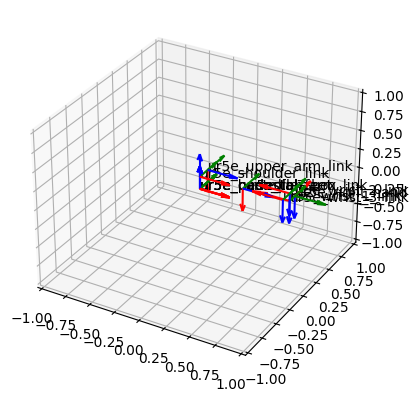

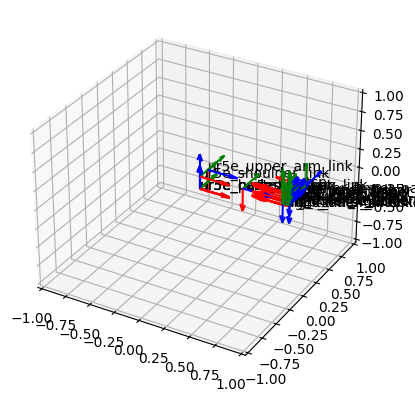

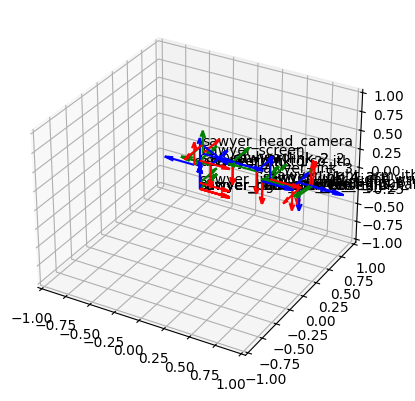

In [29]:
visualize_default_forward_kinematics(
    prefix="./urdf/ur5e/",
    urdf_path="ur5e.urdf",
)

visualize_default_forward_kinematics(
    prefix="./urdf/ur5e/",
    urdf_path="ur5e_with_robotiq140.urdf",
)

visualize_default_forward_kinematics(
    prefix="./urdf/sawyer/",
    urdf_path="sawyer.urdf",
)